<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/f/ff/Logo_uninorte_colombia.jpg/1200px-Logo_uninorte_colombia.jpg" width=60%></img>

<font size=12>Proyecto Machine Learning - OPTIMIZACIÓN 2393</font>
* Luna Julio Martinez
* Jaymed Daniel Linero Caro
* Diego Luis Linero Ramirez
* Juan David Maestre Ramirez
* Edinson Alberto Noriega Molina


# Librerias

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
#import folium
import math
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **Creación del Dataframe**

In [4]:
#Lectura del dataset

df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Optimizacion/co_properties.csv')
#df = pd.read_csv('/content/co_properties.csv')

In [5]:
df.columns

Index(['id', 'ad_type', 'start_date', 'end_date', 'created_on', 'lat', 'lon',
       'l1', 'l2', 'l3', 'l4', 'l5', 'l6', 'rooms', 'bedrooms', 'bathrooms',
       'surface_total', 'surface_covered', 'price', 'currency', 'price_period',
       'title', 'description', 'property_type', 'operation_type'],
      dtype='object')

In [6]:
# Columnas escogidas
new_df = df[['lat', 'lon', 'l1', 'l2', 'l3', 'rooms', 'bedrooms', 'bathrooms',
             'surface_total', 'surface_covered', 'price', 'currency', 'property_type', 'operation_type']]

In [7]:
new_df

,lat,lon,l1,l2,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,currency,property_type,operation_type
0,3.921000,-76.506000,Colombia,Valle del Cauca,NaN,NaN,6.0,7.0,NaN,NaN,1.300000e+09,COP,Casa,Venta
1,3.357700,-76.541811,Colombia,Valle del Cauca,Cali,NaN,NaN,7.0,NaN,NaN,2.800000e+09,COP,Casa,Venta
2,3.357700,-76.541811,Colombia,Valle del Cauca,Cali,NaN,NaN,7.0,NaN,NaN,2.800000e+09,COP,Casa,Venta
3,3.364000,-76.538000,Colombia,Valle del Cauca,Cali,NaN,5.0,8.0,NaN,NaN,3.500000e+09,COP,Casa,Venta
4,3.391000,-76.517000,Colombia,Valle del Cauca,Cali,NaN,8.0,9.0,NaN,NaN,4.800000e+08,COP,Casa,Venta
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999995,6.186412,-75.658630,Colombia,Antioquia,Medellín,NaN,2.0,1.0,NaN,NaN,7.000000e+05,COP,Apartamento,Arriendo
999996,6.186412,-75.658630,Colombia,Antioquia,Medellín,NaN,2.0,1.0,NaN,NaN,7.000000e+05,COP,Apartamento,Arriendo
999997,6.186412,-75.658630,Colombia,Antioquia,Medellín,NaN,2.0,1.0,NaN,NaN,7.000000e+05,COP,Apartamento,Arriendo
999998,11.015336,-74.831347,Colombia,Atlántico,Barranquilla,NaN,3.0,4.0,NaN,NaN,7.000000e+08,COP,Casa,Venta


## **Limpieza del DataFrame**

In [8]:
cleandf = new_df.copy()

### Analizando columnas

In [9]:
#Cantidad de no nulos y cantidad de NaN

##columna lon
null_lon_count = new_df['lon'].isnull().sum()
print(f"Number of non-null values in lon: {null_lon_count}")

##columna lat
null_lat_count = new_df['lat'].isnull().sum()
print(f"Number of non-null values in lat: {null_lat_count}")

##columna l1
null_l1_count = new_df['l1'].isnull().sum()
print(f"Number of non-null values in l1: {null_l1_count}")

not_colombia_count = new_df['l1'].apply(lambda x: 1 if x != 'Colombia' else 0).sum()
print(f"Number of values in l1 that are not Colombia: {not_colombia_count}")

##columna l2
null_l2_count = new_df['l2'].isnull().sum()
print(f"Number of non-null values in l2: {null_l2_count}")

##columna l3
null_l3_count = new_df['l3'].isnull().sum()
print(f"Number of non-null values in l3: {null_l3_count}")

##columna rooms
null_rooms_count = new_df['rooms'].isnull().sum()
print(f"Number of non-null values in rooms: {null_rooms_count}")

##columna bedrooms
null_bedrooms_count = new_df['bedrooms'].isnull().sum()
print(f"Number of non-null values in bedrooms: {null_bedrooms_count}")

##columna bathrooms
null_bathrooms_count = new_df['bathrooms'].isnull().sum()
print(f"Number of non-null values in bathrooms: {null_bathrooms_count}")

##columna surface total
null_surface_total_count = new_df['surface_total'].isnull().sum()
print(f"Number of non-null values in surface_total: {null_surface_total_count}")

##columna surface covered
null_surface_covered_count = new_df['surface_covered'].isnull().sum()
print(f"Number of non-null values in surface_covered: {null_surface_covered_count}")

##columna price
null_price_count = new_df['price'].isnull().sum()
print(f"Number of non-null values in price: {null_price_count}")

##columna currency
null_currency_count = new_df['currency'].isnull().sum()
print(f"Number of non-null values in currency: {null_currency_count}")

not_COP_count = new_df['currency'].apply(lambda x: 1 if x != 'COP' else 0).sum()
print(f"Number of values in currency that are not COP: {not_COP_count}")

##columna property_type
null_property_type_count = new_df['property_type'].isnull().sum()
print(f"Number of non-null values in property_type: {null_property_type_count}")

### Valores distintos en la variable 'property_type'
distinct_property_types = new_df['property_type'].unique()
print(f"Distinct property types: {distinct_property_types}")

### Cantidad de valores distintos de 'Casa' y 'Apartamento'
non_casa_apartamento_count = new_df[~new_df['property_type'].isin(['Casa', 'Apartamento'])].shape[0]
print(f"Number of values not 'Casa' or 'Apartamento': {non_casa_apartamento_count}")

##columna operation_type
null_operation_type_count = new_df['operation_type'].isnull().sum()
print(f"Number of non-null values in operation_type: {null_operation_type_count}")

### Valores distintos en la variable 'operation_type'
distinct_operation_types = new_df['operation_type'].unique()
print(f"Distinct property types: {distinct_operation_types}")

### Cantidad de valores distintos de 'Venta'
non_venta_count = new_df[~new_df['operation_type'].isin(['Venta'])].shape[0]

Number of non-null values in lon: 259718
Number of non-null values in lat: 259719
Number of non-null values in l1: 0
Number of values in l1 that are not Colombia: 2
Number of non-null values in l2: 0
Number of non-null values in l3: 62812
Number of non-null values in rooms: 827913
Number of non-null values in bedrooms: 623954
Number of non-null values in bathrooms: 200507
Number of non-null values in surface_total: 958758
Number of non-null values in surface_covered: 940091
Number of non-null values in price: 509
Number of non-null values in currency: 550
Number of values in currency that are not COP: 598
Number of non-null values in property_type: 0
Distinct property types: ['Casa' 'Lote' 'Otro' 'Finca' 'Oficina' 'Apartamento' 'Local comercial'
 'Depósito' 'Parqueadero']
Number of values not 'Casa' or 'Apartamento': 214495
Number of non-null values in operation_type: 0
Distinct property types: ['Venta' 'Arriendo' 'Arriendo temporal']


### Eliminando

In [10]:
# Eliminar de 'cleandf' donde 'lat' o 'lon' sean nulos
cleandf = cleandf[cleandf['lat'].notna() & cleandf['lon'].notna()]

# Eliminar en 'l1' donde sea distinto de Colombia
cleandf = cleandf[cleandf['l1'] == 'Colombia']

# Eliminando de 'cleandf' donde 'rooms' sea nulo
cleandf = cleandf[cleandf['rooms'].notnull()]

# Eliminando de 'cleandf' donde 'bedrooms' sea nulo
cleandf = cleandf[cleandf['bedrooms'].notnull()]

# Eliminando de 'cleandf' donde 'bathrooms' sea nulo
cleandf = cleandf[cleandf['bathrooms'].notnull()]

# Eliminando de 'cleandf' donde 'surface_total' sea nulo
cleandf = cleandf[cleandf['surface_total'].notnull()]

# Eliminando de 'cleandf' donde 'surface_covered' sea nulo
cleandf = cleandf[cleandf['surface_covered'].notnull()]

# Eliminando de 'cleandf' donde 'price' sea nulo
cleandf = cleandf[cleandf['price'].notnull()]

# Eliminar en 'curency' donde sea null o distinto de  'COP'
cleandf = cleandf[cleandf['currency'] == 'COP']

#Eliminar en 'property type' donde sean distintos de Casa y Apartamento
cleandf = cleandf[cleandf['property_type'].isin(['Casa', 'Apartamento'])]

#Mantener solo las operaciones donde sean ventas 'operatyopn_type' = 'Venta'
cleandf = cleandf[cleandf['operation_type'].isin(['Venta'])]


cleandf.shape

(15244, 14)

In [11]:
cleandf

,lat,lon,l1,l2,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,currency,property_type,operation_type
183,3.440,-76.506,Colombia,Valle del Cauca,Cali,3.0,3.0,1.0,85.0,85.0,1.500000e+08,COP,Casa,Venta
412,3.432,-76.465,Colombia,Valle del Cauca,Cali,4.0,4.0,2.0,48.0,96.0,1.250000e+08,COP,Casa,Venta
413,3.432,-76.465,Colombia,Valle del Cauca,Cali,4.0,4.0,2.0,48.0,96.0,1.150000e+08,COP,Casa,Venta
854,6.293,-75.598,Colombia,Antioquia,Medellín,3.0,3.0,2.0,74.0,74.0,1.550000e+08,COP,Casa,Venta
873,4.753,-74.112,Colombia,Cundinamarca,Bogotá D.C,3.0,3.0,2.0,63.0,63.0,1.750000e+08,COP,Casa,Venta
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999865,4.729,-74.064,Colombia,Cundinamarca,Bogotá D.C,3.0,3.0,2.0,96.0,96.0,4.400000e+08,COP,Apartamento,Venta
999869,4.712,-74.083,Colombia,Cundinamarca,Bogotá D.C,3.0,3.0,3.0,186.0,186.0,9.800000e+08,COP,Apartamento,Venta
999870,4.717,-74.080,Colombia,Cundinamarca,Bogotá D.C,4.0,4.0,3.0,175.0,175.0,1.300000e+09,COP,Apartamento,Venta
999871,4.713,-74.082,Colombia,Cundinamarca,Bogotá D.C,3.0,3.0,3.0,190.0,190.0,9.500000e+08,COP,Apartamento,Venta


## **Normalizando**

In [12]:
# Create two new columns for 'Casa' and 'Apartamento'
cleandf['Casa'] = cleandf['property_type'].apply(lambda x: 1 if x == 'Casa' else 0)
cleandf['Apartamento'] = cleandf['property_type'].apply(lambda x: 1 if x == 'Apartamento' else 0)


cleandf['price'] = list(map(lambda x: 0 if x==0 else math.log10(x), cleandf['price']))

# Drop the original 'property_type' column
cleandf = cleandf.drop('property_type', axis=1)

# Display the updated DataFrame
cleandf


,lat,lon,l1,l2,l3,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,currency,operation_type,Casa,Apartamento
183,3.440,-76.506,Colombia,Valle del Cauca,Cali,3.0,3.0,1.0,85.0,85.0,8.176091,COP,Venta,1,0
412,3.432,-76.465,Colombia,Valle del Cauca,Cali,4.0,4.0,2.0,48.0,96.0,8.096910,COP,Venta,1,0
413,3.432,-76.465,Colombia,Valle del Cauca,Cali,4.0,4.0,2.0,48.0,96.0,8.060698,COP,Venta,1,0
854,6.293,-75.598,Colombia,Antioquia,Medellín,3.0,3.0,2.0,74.0,74.0,8.190332,COP,Venta,1,0
873,4.753,-74.112,Colombia,Cundinamarca,Bogotá D.C,3.0,3.0,2.0,63.0,63.0,8.243038,COP,Venta,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999865,4.729,-74.064,Colombia,Cundinamarca,Bogotá D.C,3.0,3.0,2.0,96.0,96.0,8.643453,COP,Venta,0,1
999869,4.712,-74.083,Colombia,Cundinamarca,Bogotá D.C,3.0,3.0,3.0,186.0,186.0,8.991226,COP,Venta,0,1
999870,4.717,-74.080,Colombia,Cundinamarca,Bogotá D.C,4.0,4.0,3.0,175.0,175.0,9.113943,COP,Venta,0,1
999871,4.713,-74.082,Colombia,Cundinamarca,Bogotá D.C,3.0,3.0,3.0,190.0,190.0,8.977724,COP,Venta,0,1


In [13]:
finaldf = cleandf[['lat', 'lon', 'rooms', 'bedrooms', 'bathrooms', 'Casa', 'Apartamento', 'surface_total', 'surface_covered', 'price']]
finaldf

,lat,lon,rooms,bedrooms,bathrooms,Casa,Apartamento,surface_total,surface_covered,price
183,3.440,-76.506,3.0,3.0,1.0,1,0,85.0,85.0,8.176091
412,3.432,-76.465,4.0,4.0,2.0,1,0,48.0,96.0,8.096910
413,3.432,-76.465,4.0,4.0,2.0,1,0,48.0,96.0,8.060698
854,6.293,-75.598,3.0,3.0,2.0,1,0,74.0,74.0,8.190332
873,4.753,-74.112,3.0,3.0,2.0,1,0,63.0,63.0,8.243038
...,...,...,...,...,...,...,...,...,...,...
999865,4.729,-74.064,3.0,3.0,2.0,0,1,96.0,96.0,8.643453
999869,4.712,-74.083,3.0,3.0,3.0,0,1,186.0,186.0,8.991226
999870,4.717,-74.080,4.0,4.0,3.0,0,1,175.0,175.0,9.113943
999871,4.713,-74.082,3.0,3.0,3.0,0,1,190.0,190.0,8.977724


# **Modelos**


In [14]:
corr = finaldf.corr()

finaldf

,lat,lon,rooms,bedrooms,bathrooms,Casa,Apartamento,surface_total,surface_covered,price
183,3.440,-76.506,3.0,3.0,1.0,1,0,85.0,85.0,8.176091
412,3.432,-76.465,4.0,4.0,2.0,1,0,48.0,96.0,8.096910
413,3.432,-76.465,4.0,4.0,2.0,1,0,48.0,96.0,8.060698
854,6.293,-75.598,3.0,3.0,2.0,1,0,74.0,74.0,8.190332
873,4.753,-74.112,3.0,3.0,2.0,1,0,63.0,63.0,8.243038
...,...,...,...,...,...,...,...,...,...,...
999865,4.729,-74.064,3.0,3.0,2.0,0,1,96.0,96.0,8.643453
999869,4.712,-74.083,3.0,3.0,3.0,0,1,186.0,186.0,8.991226
999870,4.717,-74.080,4.0,4.0,3.0,0,1,175.0,175.0,9.113943
999871,4.713,-74.082,3.0,3.0,3.0,0,1,190.0,190.0,8.977724


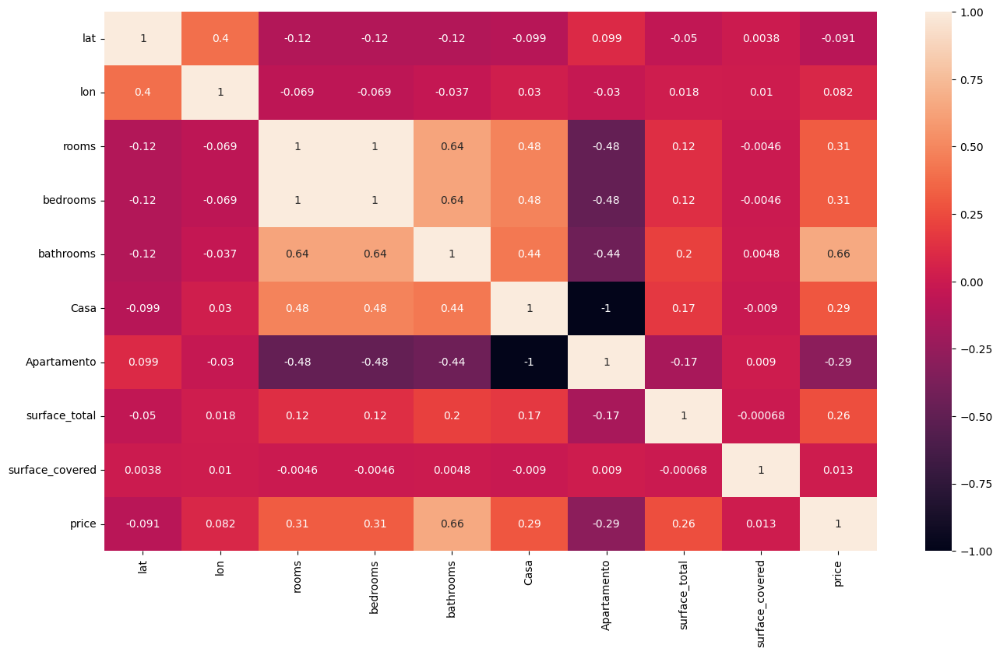

In [15]:
plt.figure(figsize=(16, 9))
sns.heatmap(corr, vmin=-1, vmax=1, annot=True)
plt.show()

In [50]:
inputs = ['lat','lon', 'rooms', 'bedrooms', 'bathrooms',  'Casa','Apartamento', 'surface_total']
output= ['price']

## ***Reg lineal***

In [52]:
score1 = []

for i in range(1000):
  dfTrain, dfTest = train_test_split(finaldf, test_size=.3, random_state=i+1)
  lr = LinearRegression()
  lr.fit(dfTrain[inputs], dfTrain[output])
  score1.append(lr.score(dfTest[inputs], dfTest[output]))

  predicciones = lr.predict(dfTest[inputs]).flatten()
  valorsreales = dfTest[output].values.flatten()


<Axes: ylabel='Density'>

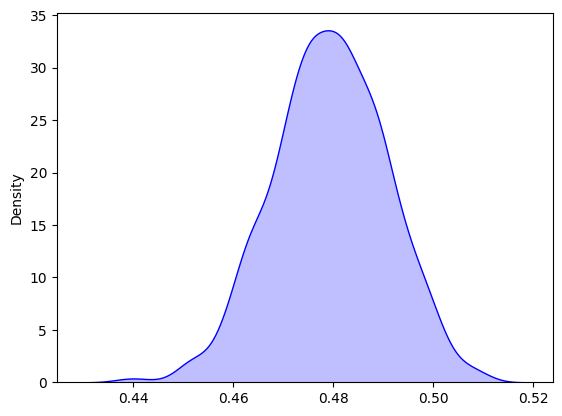

In [53]:
sns.kdeplot(x=score1, color='b', fill=True)

## ***RandomForest***

In [54]:
score2 = []

for i in range(100):
  dfTrain, dfTest = train_test_split(finaldf, test_size=.3, random_state=i+1)
  rf = RandomForestRegressor(n_estimators=500, random_state=10)
  rf.fit(dfTrain[inputs], dfTrain[output])
  score2.append(rf.score(dfTest[inputs], dfTest[output]))

  predicciones = rf.predict(dfTest[inputs]).flatten()
  valorsreales = dfTest[output].values.flatten()

<ipython-input-54-6eee5a62cfbe>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(dfTrain[inputs], dfTrain[output])
<ipython-input-54-6eee5a62cfbe>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(dfTrain[inputs], dfTrain[output])
<ipython-input-54-6eee5a62cfbe>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(dfTrain[inputs], dfTrain[output])
<ipython-input-54-6eee5a62cfbe>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(dfTrain[inputs], dfTrain[output])
<ipython-input-54-6eee5a62cfbe>:6: DataConversionWarning: A column-v

KeyboardInterrupt: 

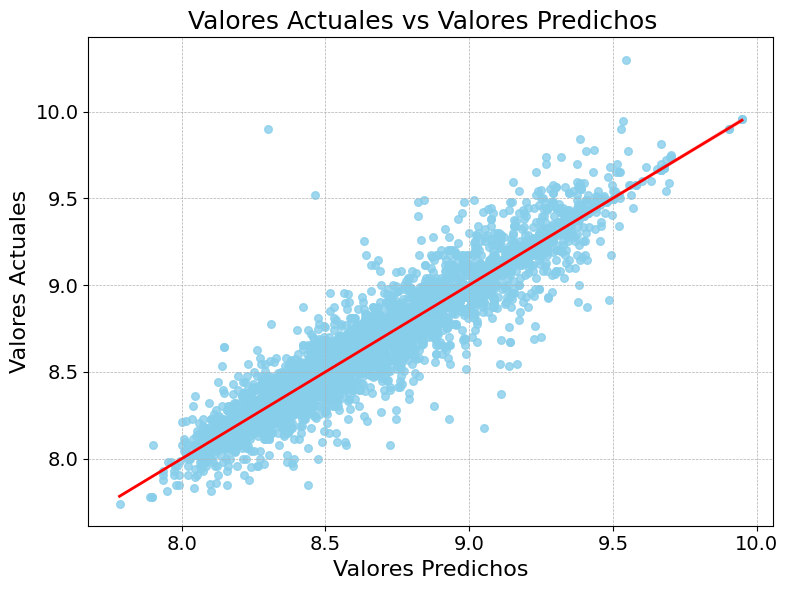

In [ ]:
  plt.figure(figsize=(8, 6))
  reg_plot = sns.regplot(x=predicciones, y=valorsreales,
                        scatter_kws={'color': 'skyblue', 's': 30},
                        line_kws={'color': 'red', 'lw': 2})

  plt.title('Valores Actuales vs Valores Predichos  ' , fontsize=18)
  plt.xlabel('Valores Predichos', fontsize=16)
  plt.ylabel('Valores Actuales', fontsize=16)

  plt.grid(True, which='both', linestyle='--', linewidth=0.5)

  plt.xticks(fontsize=14)
  plt.yticks(fontsize=14)

  plt.tight_layout()
  plt.show()

In [ ]:
dfTest.head(3)

,lat,lon,rooms,bedrooms,bathrooms,Casa,Apartamento,surface_total,surface_covered,price
864585,11.001,-74.810,3.0,3.0,2.0,0,1,112.0,112.0,8.591065
230299,6.189,-75.561,4.0,4.0,3.0,0,1,204.0,204.0,8.806180
133816,10.981,-74.782,2.0,2.0,3.0,0,1,99.0,99.0,8.676409


<Axes: ylabel='Density'>

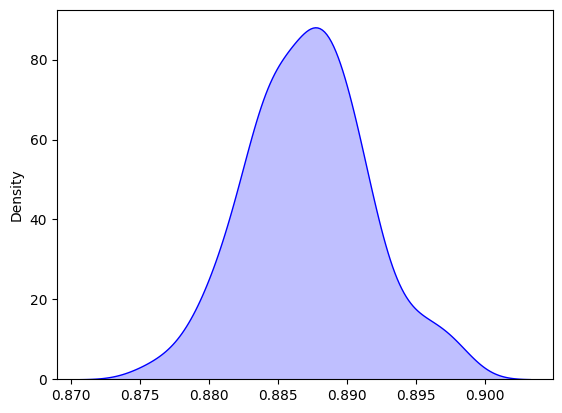

In [ ]:
sns.kdeplot(x=score2, color='b', fill=True)

## ***Redes Neuronales***

<img src="https://github.com/DiegoLuis62/Optimization/blob/main/Images/nn.jpg?raw=true" width=60%></img>


In [61]:
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import accuracy_score

In [62]:
inputs = ['lat','lon', 'rooms', 'bedrooms', 'bathrooms',  'Casa','Apartamento', 'surface_total']
output= ['price']

In [ ]:
score = []


for i in range(100):
  dfTrain, dfTest = train_test_split(finaldf, test_size=.3, random_state=i+1)
  mlp_ = MLPRegressor(hidden_layer_sizes=(21, 21, 21, 21, 21, 21), activation='tanh', alpha=0.001,)
  mlp_.fit(dfTrain[inputs], dfTrain[output])
  score.append(mlp_.score(dfTest[inputs], dfTest[output]))
  print(i)

  predicciones = mlp_.predict(dfTest[inputs]).flatten()
  valorsreales = dfTest[output].values.flatten()



In [ ]:
print(f"The mean of the scores is: {np.mean(score)}")

The mean of the scores is: 0.7299009147797824


In [ ]:
score

<Axes: ylabel='Density'>

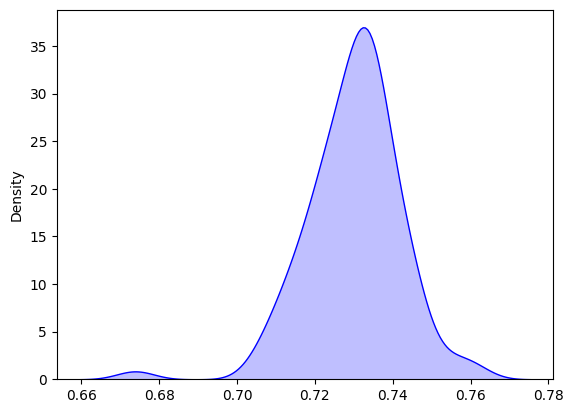

In [ ]:
sns.kdeplot(x=score, color='b', fill=True)

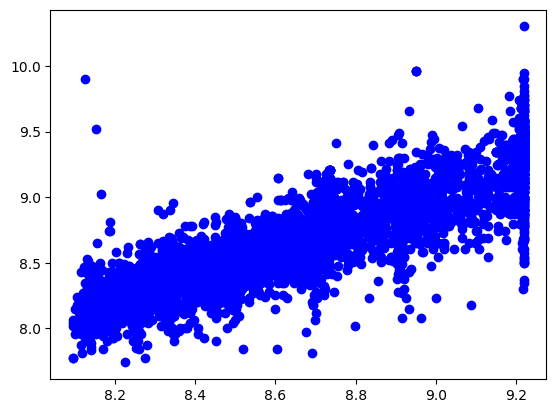

In [ ]:
predicciones = mlp_.predict(dfTest[inputs]).flatten()
valorsreales = dfTest[output].values.flatten()

plt.plot(predicciones, valorsreales, 'ob')

# **Mapa**

In [16]:
mapadf = finaldf[['lat', 'lon', 'price']]
mapadf

,lat,lon,price
183,3.440,-76.506,8.176091
412,3.432,-76.465,8.096910
413,3.432,-76.465,8.060698
854,6.293,-75.598,8.190332
873,4.753,-74.112,8.243038
...,...,...,...
999865,4.729,-74.064,8.643453
999869,4.712,-74.083,8.991226
999870,4.717,-74.080,9.113943
999871,4.713,-74.082,8.977724


In [17]:
!pip install --upgrade folium

In [71]:
import folium
from folium.plugins import MarkerCluster
from folium.features import DivIcon

# Create a base map
map = folium.Map(location=[mapadf['lat'].mean(), mapadf['lon'].mean()], zoom_start=10)

# Create a marker cluster
marker_cluster = MarkerCluster().add_to(map)

# For each row in the DataFrame, create a marker and add it to the cluster
for i in mapadf.index:
  lat = mapadf.loc[i, 'lat']
  lon = mapadf.loc[i, 'lon']
  price = mapadf.loc[i, 'price']

  marker = folium.Marker(
    location=[lat, lon],
    icon=DivIcon(
      icon_size=(20, 20),
      icon_anchor=(0, 0),
      html=f'<div style="font-size: 12; color:#d35400;"><b>{price}</b></div>',
    )
  )
  marker_cluster.add_child(marker)

# Display the map
map


In [72]:
map.save('map.html')


In [73]:
import matplotlib.pyplot as plt
import folium
import numpy as np

mapadf = finaldf[['lat', 'lon', 'price']]

# Create a base map
map = folium.Map(location=[mapadf['lat'].mean(), mapadf['lon'].mean()], zoom_start=10)

# Create a color map
cmap = plt.cm.jet

# Normalize the price values
norm_price = (mapadf['price'] - mapadf['price'].min()) / (mapadf['price'].max() - mapadf['price'].min())

# Create a marker for each row in the DataFrame
for i in mapadf.index:
    lat = mapadf.loc[i, 'lat']
    lon = mapadf.loc[i, 'lon']
    price = mapadf.loc[i, 'price']

    # Set the color of the marker based on the normalized price
    color = cmap(norm_price[i])

    # Create the marker
    marker = folium.CircleMarker(
        location=[lat, lon],
        radius=5,
        color=color,
        fill=True,
        fill_color=color
    )

    # Add the price as a label to the marker
    marker.add_child(folium.Popup(f"Price: {price}"))

    # Add the marker to the map
    map.add_child(marker)

# Display the map
map


In [74]:
map.save('map2.html')
